In [86]:
!pip install --upgrade scikit-learn

Requirement already up-to-date: scikit-learn in /opt/conda/lib/python3.6/site-packages (0.24.2)


In [88]:
# import libraries here; add more as necessary
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.impute import SimpleImputer

# magic word for producing visualizations in notebook
%matplotlib inline

ImportError: cannot import name '_deprecate_positional_args'

# Objective

Create a customer segmentation report based on census information and e-mail sales by a company, using demographic information to determine how customers are different to general population. Then use this analysis to make predictions to figure out wich members of the general population are more lekely to become a customer for the e-mail order company, <b>based on a unsupervised machine learning model</b>.

Based on this report, the company would be able to define a marketing strategy so as to reach more consumer out.

## Get to Know the Data (Metadata)

There are four data files associated with this project:

- `Udacity_AZDIAS_052018.csv`: Demographics data for the general population of Germany; 891 211 persons (rows) x 366 features (columns).
- `Udacity_CUSTOMERS_052018.csv`: Demographics data for customers of a mail-order company; 191 652 persons (rows) x 369 features (columns).
- `Udacity_MAILOUT_052018_TRAIN.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 982 persons (rows) x 367 (columns).
- `Udacity_MAILOUT_052018_TEST.csv`: Demographics data for individuals who were targets of a marketing campaign; 42 833 persons (rows) x 366 (columns).

Each row of the demographics files represents a single person, but also includes information outside of individuals, including information about their household, building, and neighborhood. Use the information from the first two files to figure out how customers ("CUSTOMERS") are similar to or differ from the general population at large ("AZDIAS"), then use your analysis to make predictions on the other two files ("MAILOUT"), predicting which recipients are most likely to become a customer for the mail-order company.

The "CUSTOMERS" file contains three extra columns ('CUSTOMER_GROUP', 'ONLINE_PURCHASE', and 'PRODUCT_GROUP'), which provide broad information about the customers depicted in the file. The original "MAILOUT" file included one additional column, "RESPONSE", which indicated whether or not each recipient became a customer of the company. For the "TRAIN" subset, this column has been retained, but in the "TEST" subset it has been removed; it is against that withheld column that your final predictions will be assessed in the Kaggle competition.

Otherwise, all of the remaining columns are the same between the three data files. For more information about the columns depicted in the files, you can refer to two Excel spreadsheets provided in the workspace. [One of them](./DIAS Information Levels - Attributes 2017.xlsx) is a top-level list of attributes and descriptions, organized by informational category. [The other](./DIAS Attributes - Values 2017.xlsx) is a detailed mapping of data values for each feature in alphabetical order.

In the below cell, we've provided some initial code to load in the first two datasets. Note for all of the `.csv` data files in this project that they're semicolon (`;`) delimited, so an additional argument in the [`read_csv()`](https://pandas.pydata.org/pandas-docs/stable/generated/pandas.read_csv.html) call has been included to read in the data properly. Also, considering the size of the datasets, it may take some time for them to load completely.

You'll notice when the data is loaded in that a warning message will immediately pop up. Before you really start digging into the modeling and analysis, you're going to need to perform some cleaning. Take some time to browse the structure of the data and look over the informational spreadsheets to understand the data values. Make some decisions on which features to keep, which features to drop, and if any revisions need to be made on data formats. It'll be a good idea to create a function with pre-processing steps, since you'll need to clean all of the datasets before you work with them.

The DIAS information level includes the sort of mindful by every row:

- social minded
- familiar minded
- religious
- material minded
- dreamily
- sensual minded
- eventful orientated
- cultural minded
- rational mind
- critical minded
- dominant minded
- fightfull attitude
- traditional minded
- traditional minded

# The approach used to know can be split in the following steps:

###    A. Extract, Transform and Load

 <a font-color: blue> Extract:</a> Gathering the information from every dataset.
 <p>
 <a font-color: blue> Transform:</a> Data cleaning, summarization, selection, joining, filtering and aggregating.
 <p>
 <a font-color: blue> Load:</a> Relational or not relational database, locally or in AWS.

###    B. Exploratory Data Analysis (EDA)
###    C. Unsupervised Machine Learning Model: Clustering analysis
###    D. Customer segmentation report
###    E. Supervised Machine Learning Model: Targeting for Marketing


<h1 style="color:blue"> A. Extract, Transform and Load</h1>
    
### Extract

In [3]:
# load in the data
azdias = pd.read_csv('../../data/Term2/capstone/arvato_data/Udacity_AZDIAS_052018.csv', sep=';')
customers = pd.read_csv('../../data/Term2/capstone/arvato_data/Udacity_CUSTOMERS_052018.csv', sep=';')

/opt/conda/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2785: DtypeWarning: Columns (18,19) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
#display all the columns of dataset
pd.set_option('display.max_columns',None)

In [5]:
#display all the rows of dataset
pd.set_option('display.max_rows',None)

In [6]:
# Shape and head of general data
print(f"General population shape: {azdias.shape}")
print(f"General costumer shape: {customers.shape}")

General population shape: (891221, 366)
General costumer shape: (191652, 369)



### Transform

In [7]:
# Overview of features
azdias.head()

,LNR,AGER_TYP,AKT_DAT_KL,ALTER_HH,ALTER_KIND1,ALTER_KIND2,ALTER_KIND3,ALTER_KIND4,ALTERSKATEGORIE_FEIN,ANZ_HAUSHALTE_AKTIV,ANZ_HH_TITEL,ANZ_KINDER,ANZ_PERSONEN,ANZ_STATISTISCHE_HAUSHALTE,ANZ_TITEL,ARBEIT,BALLRAUM,CAMEO_DEU_2015,CAMEO_DEUG_2015,CAMEO_INTL_2015,CJT_GESAMTTYP,CJT_KATALOGNUTZER,CJT_TYP_1,CJT_TYP_2,CJT_TYP_3,CJT_TYP_4,CJT_TYP_5,CJT_TYP_6,D19_BANKEN_ANZ_12,D19_BANKEN_ANZ_24,D19_BANKEN_DATUM,D19_BANKEN_DIREKT,D19_BANKEN_GROSS,D19_BANKEN_LOKAL,D19_BANKEN_OFFLINE_DATUM,D19_BANKEN_ONLINE_DATUM,D19_BANKEN_ONLINE_QUOTE_12,D19_BANKEN_REST,D19_BEKLEIDUNG_GEH,D19_BEKLEIDUNG_REST,D19_BILDUNG,D19_BIO_OEKO,D19_BUCH_CD,D19_DIGIT_SERV,D19_DROGERIEARTIKEL,D19_ENERGIE,D19_FREIZEIT,D19_GARTEN,D19_GESAMT_ANZ_12,D19_GESAMT_ANZ_24,D19_GESAMT_DATUM,D19_GESAMT_OFFLINE_DATUM,D19_GESAMT_ONLINE_DATUM,D19_GESAMT_ONLINE_QUOTE_12,D19_HANDWERK,D19_HAUS_DEKO,D19_KINDERARTIKEL,D19_KONSUMTYP,D19_KONSUMTYP_MAX,D19_KOSMETIK,D19_LEBENSMITTEL,D19_LETZTER_KAUF_BRANCHE,D19_LOTTO,D19_NAHRUNGSERGAENZUNG,D19_RATGEBER,D19_REISEN,D19_SAMMELARTIKEL,D19_SCHUHE,D19_SONSTIGE,D19_SOZIALES,D19_TECHNIK,D19_TELKO_ANZ_12,D19_TELKO_ANZ_24,D19_TELKO_DATUM,D19_TELKO_MOBILE,D19_TELKO_OFFLINE_DATUM,D19_TELKO_ONLINE_DATUM,D19_TELKO_ONLINE_QUOTE_12,D19_TELKO_REST,D19_TIERARTIKEL,D19_VERSAND_ANZ_12,D19_VERSAND_ANZ_24,D19_VERSAND_DATUM,D19_VERSAND_OFFLINE_DATUM,D19_VERSAND_ONLINE_DATUM,D19_VERSAND_ONLINE_QUOTE_12,D19_VERSAND_REST,D19_VERSI_ANZ_12,D19_VERSI_ANZ_24,D19_VERSI_DATUM,D19_VERSI_OFFLINE_DATUM,D19_VERSI_ONLINE_DATUM,D19_VERSI_ONLINE_QUOTE_12,D19_VERSICHERUNGEN,D19_VOLLSORTIMENT,D19_WEIN_FEINKOST,DSL_FLAG,EINGEFUEGT_AM,EINGEZOGENAM_HH_JAHR,EWDICHTE,EXTSEL992,FINANZ_ANLEGER,FINANZ_HAUSBAUER,FINANZ_MINIMALIST,FINANZ_SPARER,FINANZ_UNAUFFAELLIGER,FINANZ_VORSORGER,FINANZTYP,FIRMENDICHTE,GEBAEUDETYP,GEBAEUDETYP_RASTER,GEBURTSJAHR,GEMEINDETYP,GFK_URLAUBERTYP,GREEN_AVANTGARDE,HEALTH_TYP,HH_DELTA_FLAG,HH_EINKOMMEN_SCORE,INNENSTADT,KBA05_ALTER1,KBA05_ALTER2,KBA05_ALTER3,KBA05_ALTER4,KBA05_ANHANG,KBA05_ANTG1,KBA05_ANTG2,KBA05_ANTG3,KBA05_ANTG4,KBA05_AUTOQUOT,KBA05_BAUMAX,KBA05_CCM1,KBA05_CCM2,KBA05_CCM3,KBA05_CCM4,KBA05_DIESEL,KBA05_FRAU,KBA05_GBZ,KBA05_HERST1,KBA05_HERST2,KBA05_HERST3,KBA05_HERST4,KBA05_HERST5,KBA05_HERSTTEMP,KBA05_KRSAQUOT,KBA05_KRSHERST1,KBA05_KRSHERST2,KBA05_KRSHERST3,KBA05_KRSKLEIN,KBA05_KRSOBER,KBA05_KRSVAN,KBA05_KRSZUL,KBA05_KW1,KBA05_KW2,KBA05_KW3,KBA05_MAXAH,KBA05_MAXBJ,KBA05_MAXHERST,KBA05_MAXSEG,KBA05_MAXVORB,KBA05_MOD1,KBA05_MOD2,KBA05_MOD3,KBA05_MOD4,KBA05_MOD8,KBA05_MODTEMP,KBA05_MOTOR,KBA05_MOTRAD,KBA05_SEG1,KBA05_SEG10,KBA05_SEG2,KBA05_SEG3,KBA05_SEG4,KBA05_SEG5,KBA05_SEG6,KBA05_SEG7,KBA05_SEG8,KBA05_SEG9,KBA05_VORB0,KBA05_VORB1,KBA05_VORB2,KBA05_ZUL1,KBA05_ZUL2,KBA05_ZUL3,KBA05_ZUL4,KBA13_ALTERHALTER_30,KBA13_ALTERHALTER_45,KBA13_ALTERHALTER_60,KBA13_ALTERHALTER_61,KBA13_ANTG1,KBA13_ANTG2,KBA13_ANTG3,KBA13_ANTG4,KBA13_ANZAHL_PKW,KBA13_AUDI,KBA13_AUTOQUOTE,KBA13_BAUMAX,KBA13_BJ_1999,KBA13_BJ_2000,KBA13_BJ_2004,KBA13_BJ_2006,KBA13_BJ_2008,KBA13_BJ_2009,KBA13_BMW,KBA13_CCM_0_1400,KBA13_CCM_1000,KBA13_CCM_1200,KBA13_CCM_1400,KBA13_CCM_1401_2500,KBA13_CCM_1500,KBA13_CCM_1600,KBA13_CCM_1800,KBA13_CCM_2000,KBA13_CCM_2500,KBA13_CCM_2501,KBA13_CCM_3000,KBA13_CCM_3001,KBA13_FAB_ASIEN,KBA13_FAB_SONSTIGE,KBA13_FIAT,KBA13_FORD,KBA13_GBZ,KBA13_HALTER_20,KBA13_HALTER_25,KBA13_HALTER_30,KBA13_HALTER_35,KBA13_HALTER_40,KBA13_HALTER_45,KBA13_HALTER_50,KBA13_HALTER_55,KBA13_HALTER_60,KBA13_HALTER_65,KBA13_HALTER_66,KBA13_HERST_ASIEN,KBA13_HERST_AUDI_VW,KBA13_HERST_BMW_BENZ,KBA13_HERST_EUROPA,KBA13_HERST_FORD_OPEL,KBA13_HERST_SONST,KBA13_HHZ,KBA13_KMH_0_140,KBA13_KMH_110,KBA13_KMH_140,KBA13_KMH_140_210,KBA13_KMH_180,KBA13_KMH_210,KBA13_KMH_211,KBA13_KMH_250,KBA13_KMH_251,KBA13_KRSAQUOT,KBA13_KRSHERST_AUDI_VW,KBA13_KRSHERST_BMW_BENZ,KBA13_KRSHERST_FORD_OPEL,KBA13_KRSSEG_KLEIN,KBA13_KRSSEG_OBER,KBA13_KRSSEG_VAN,KBA13_KRSZUL_NEU,KBA13_KW_0_60,KBA13_KW_110,KBA13_KW_120,KBA13_KW_121,KBA13_KW_30,KBA13_KW_40,KBA13_KW_50,KBA13_KW_60,KBA13_KW_61_120,KBA13_KW_70,KBA13_KW_80,

In [8]:
# Verify the shape (observations and variables)
print(f'Azdias, the general population dataset, has {azdias.shape[0]} observations and {azdias.shape[1]} columns')
print(f'customers, the customers dataset, has {customers.shape[0]} observations and {customers.shape[1]} columns')
      

Azdias, the general population dataset, has 891221 observations and 366 columns
customers, the customers dataset, has 191652 observations and 369 columns


In [9]:
# We need to confirm which are the 3 additional variables are in customers
print(f'These are the additional variables in {customers.columns.symmetric_difference(azdias.columns)}')

These are the additional variables in Index(['CUSTOMER_GROUP', 'ONLINE_PURCHASE', 'PRODUCT_GROUP'], dtype='object')


In [10]:
# Colomuns information, knowing more about the series
toplevel_features = pd.read_excel('./DIAS Information Levels - Attributes 2017.xlsx') 
detailed_features = pd.read_excel("./DIAS Attributes - Values 2017.xlsx")

In [11]:
detailed_features.tail()

,Unnamed: 0,Attribute,Description,Value,Meaning
2253,NaN,NaN,NaN,2,smart
2254,NaN,NaN,NaN,3,fair supplied
2255,NaN,NaN,NaN,4,price driven
2256,NaN,NaN,NaN,5,seeking orientation
2257,NaN,NaN,NaN,6,indifferent


In [12]:
toplevel_features.tail()

,Unnamed: 0,Information level,Attribute,Description,Additional notes
308,NaN,Community,ARBEIT,share of unemployed person in the community,NaN
309,NaN,NaN,EINWOHNER,inhabitants,NaN
310,NaN,NaN,GKZ,standardized community-code,NaN
311,NaN,NaN,ORTSGR_KLS9,classified number of inhabitants,NaN
312,NaN,NaN,RELAT_AB,share of unemployed in relation to the county ...,NaN


In [13]:
#Getting the general information in census and users
print(f'The azdias: {azdias.info()}')
print(f'The customers: {customers.info()}')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891221 entries, 0 to 891220
Columns: 366 entries, LNR to ALTERSKATEGORIE_GROB
dtypes: float64(267), int64(93), object(6)
memory usage: 2.4+ GB
The azdias: None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 191652 entries, 0 to 191651
Columns: 369 entries, LNR to ALTERSKATEGORIE_GROB
dtypes: float64(267), int64(94), object(8)
memory usage: 539.5+ MB
The customers: None


In [14]:
# we need the same types in every column, but we would like to know the unique for every column
for col in azdias:
    print(f'{col} {azdias[col].unique()}')

LNR [910215 910220 910225 ..., 825772 825776 825787]
AGER_TYP [-1  2  3  0  1]
AKT_DAT_KL [ nan   9.   1.   5.   8.   7.   6.   4.   3.   2.]
ALTER_HH [ nan   0.  17.  13.  20.  10.  14.  16.  21.  11.  19.  15.   9.  18.   8.
   7.  12.   4.   3.   6.   5.   2.   1.]
ALTER_KIND1 [ nan  17.  10.  18.  13.  16.  11.   6.   8.   9.  15.  14.   7.  12.   4.
   3.   5.   2.]
ALTER_KIND2 [ nan  13.   8.  12.  10.   7.  16.  15.  14.  17.   5.   9.  18.  11.   6.
   4.   3.   2.]
ALTER_KIND3 [ nan  10.  18.  17.  16.   8.  15.   9.  12.  13.  14.  11.   7.   5.   6.
   4.]
ALTER_KIND4 [ nan  10.   9.  16.  14.  13.  11.  18.  17.  15.   8.  12.   7.]
ALTERSKATEGORIE_FEIN [ nan  21.  17.  13.  14.  10.  16.  20.  11.  19.  15.  18.   9.  22.  12.
   0.   8.   7.  23.   4.  24.   6.   3.   2.   5.  25.   1.]
ANZ_HAUSHALTE_AKTIV [  nan   11.   10.    1.    3.    5.    4.    6.    2.    9.    0.   14.
   13.    8.    7.   44.   25.   36.   16.  272.   33.   15.   12.   22.
   21.   20.   67.   2

In [15]:
for col in customers:
    print(f'{col} {customers[col].unique()}')

LNR [  9626   9628 143872 ..., 148813 148852 148883]
AGER_TYP [ 2 -1  1  0  3]
AKT_DAT_KL [  1.   9.   3.   7.   5.   2.  nan   4.   6.   8.]
ALTER_HH [ 10.  11.   6.   8.  20.   5.  14.  21.  15.  17.   0.  19.   9.  12.  13.
  nan  18.   7.  16.   4.   2.   3.]
ALTER_KIND1 [ nan   8.  12.   9.   7.  13.  17.  14.  18.  11.  16.   6.  10.  15.   5.
   3.   4.   2.]
ALTER_KIND2 [ nan   9.  17.  10.  14.  13.  12.  11.  16.  18.  15.   7.   5.   8.   6.
   3.   2.   4.]
ALTER_KIND3 [ nan  13.  16.  18.  15.  17.  14.  12.  11.  10.   8.   7.   9.   6.   5.]
ALTER_KIND4 [ nan  18.  12.  16.  13.  17.  11.  14.  15.  10.   8.]
ALTERSKATEGORIE_FEIN [ 10.  nan   0.   8.  14.   9.   4.  13.   6.  12.  19.  17.  15.  11.  16.
   7.  18.  21.  25.  20.  24.   5.   2.  22.   3.  23.]
ANZ_HAUSHALTE_AKTIV [   1.   nan    0.    7.   74.    9.   17.   12.   29.    2.   45.   10.
   14.   15.   55.    6.    5.  108.    3.   25.   18.    4.   11.   19.
    8.   26.   43.   63.   47.   16.   31.   57.

In [16]:
# There are 6 columns object. The dtype object comes from NumPy, it describes the type of element in a ndarray. 
# Every element in an ndarray must have the same size in bytes. For int64 and float64, they are 8 bytes. 
# But for strings, the length of the string is not fixed. So instead of saving the bytes of strings in the ndarray directly, 
# Pandas uses an object ndarray, which saves pointers to objects; because of this the dtype of this kind ndarray is object.

# Lets see the 6 object series in azdias and 8 object series in customers dataset

print(f'The columns as object in customers: {customers.select_dtypes(object).columns}')
print(f'The columns as object in azdias: {azdias.select_dtypes(object).columns}')


The columns as object in customers: Index(['CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015',
       'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM', 'OST_WEST_KZ',
       'PRODUCT_GROUP', 'CUSTOMER_GROUP'],
      dtype='object')
The columns as object in azdias: Index(['CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015',
       'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM', 'OST_WEST_KZ'],
      dtype='object')


In [17]:
# lets understand the variables dtype objects:
azdias_objects = azdias[['CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015',
       'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM', 'OST_WEST_KZ']]

for col in azdias_objects:
    print(f'{col} {azdias[col].unique()}')

CAMEO_DEU_2015 [nan '8A' '4C' '2A' '6B' '8C' '4A' '2D' '1A' '1E' '9D' '5C' '8B' '7A' '5D'
 '9E' '9B' '1B' '3D' '4E' '4B' '3C' '5A' '7B' '9A' '6D' '6E' '2C' '7C' '9C'
 '7D' '5E' '1D' '8D' '6C' '6A' '5B' '4D' '3A' '2B' '7E' '3B' '6F' '5F' '1C'
 'XX']
CAMEO_DEUG_2015 [nan 8.0 4.0 2.0 6.0 1.0 9.0 5.0 7.0 3.0 '4' '3' '7' '2' '8' '9' '6' '5'
 '1' 'X']
CAMEO_INTL_2015 [nan 51.0 24.0 12.0 43.0 54.0 22.0 14.0 13.0 15.0 33.0 41.0 34.0 55.0 25.0
 23.0 31.0 52.0 35.0 45.0 44.0 32.0 '22' '24' '41' '12' '54' '51' '44' '35'
 '23' '25' '14' '34' '52' '55' '31' '32' '15' '13' '43' '33' '45' 'XX']
D19_LETZTER_KAUF_BRANCHE [nan 'D19_UNBEKANNT' 'D19_SCHUHE' 'D19_ENERGIE' 'D19_KOSMETIK'
 'D19_VOLLSORTIMENT' 'D19_SONSTIGE' 'D19_BANKEN_GROSS'
 'D19_DROGERIEARTIKEL' 'D19_HANDWERK' 'D19_BUCH_CD' 'D19_VERSICHERUNGEN'
 'D19_VERSAND_REST' 'D19_TELKO_REST' 'D19_BANKEN_DIREKT' 'D19_BANKEN_REST'
 'D19_FREIZEIT' 'D19_LEBENSMITTEL' 'D19_HAUS_DEKO' 'D19_BEKLEIDUNG_REST'
 'D19_SAMMELARTIKEL' 'D19_TELKO_MOBILE' 'D19_REIS

In [18]:
# lets understand the variables dtype objects:
customers_objects = customers[['CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015',
       'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM', 'OST_WEST_KZ',
       'PRODUCT_GROUP', 'CUSTOMER_GROUP']]

for col in customers_objects:
    print(f'{col} {customers[col].unique()}')

CAMEO_DEU_2015 ['1A' nan '5D' '4C' '7B' '3B' '1D' '9E' '2D' '4A' '6B' '9D' '8B' '5C' '9C'
 '4E' '6C' '8C' '8A' '5B' '9B' '3D' '2A' '3C' '5F' '7A' '1E' '2C' '7C' '5A'
 '2B' '6D' '7E' '5E' '6E' '3A' '9A' '4B' '1C' '1B' '6A' '8D' '7D' '6F' '4D'
 'XX']
CAMEO_DEUG_2015 [1.0 nan 5.0 4.0 7.0 3.0 9.0 2.0 6.0 8.0 '6' '3' '8' '9' '2' '4' '1' '7'
 '5' 'X']
CAMEO_INTL_2015 [13.0 nan 34.0 24.0 41.0 23.0 15.0 55.0 14.0 22.0 43.0 51.0 33.0 25.0 44.0
 54.0 32.0 12.0 35.0 31.0 45.0 52.0 '45' '25' '55' '51' '14' '54' '43' '22'
 '15' '24' '35' '23' '12' '44' '41' '52' '31' '13' '34' '32' '33' 'XX']
D19_LETZTER_KAUF_BRANCHE ['D19_UNBEKANNT' 'D19_BANKEN_GROSS' 'D19_NAHRUNGSERGAENZUNG' 'D19_SCHUHE'
 'D19_BUCH_CD' 'D19_DROGERIEARTIKEL' 'D19_SONSTIGE' 'D19_TECHNIK'
 'D19_VERSICHERUNGEN' 'D19_TELKO_MOBILE' 'D19_VOLLSORTIMENT' nan
 'D19_HAUS_DEKO' 'D19_ENERGIE' 'D19_REISEN' 'D19_BANKEN_LOKAL'
 'D19_VERSAND_REST' 'D19_BEKLEIDUNG_REST' 'D19_FREIZEIT'
 'D19_BEKLEIDUNG_GEH' 'D19_TELKO_REST' 'D19_SAMMELARTIKEL'
 'D1

In [19]:
# Given the last information we need to transform the unknown values in missing values in three columns for every dataset
# Azdias and customers: 'CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015
# The problem of mixed types in columns is because there is actually a mix of int and string values. 
# Therefore, I will remove the string value and conver the column data type to int. Particularly for 
# 'CAMEO_DEUG_2015' and 'CAMEO_INTL_2015'

def mixed_types(df):
    '''This function is created for formating improper 
    values in columns CAMEO_DEUG_2015 and CAMEO_INTL_2015.
    Args:
    df: dataframe
    returns: transformed dataframe
    '''
    
    cols_nan = ['CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015']
    cols = ['CAMEO_DEUG_2015', 'CAMEO_INTL_2015'] #cols with int dtypes
    if set(cols_nan).issubset(df.columns):
        df[cols_nan] = df[cols_nan].replace({'X': np.nan, 'XX': np.nan})
        df[cols] = df[cols].astype(float)

    return df


In [20]:
# using the function to eliminate unknown values in customeres
customers2 = mixed_types(customers)

print(f'The columns as object in customers2: {customers2.select_dtypes(object).columns}')

The columns as object in customers2: Index(['CAMEO_DEU_2015', 'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM',
       'OST_WEST_KZ', 'PRODUCT_GROUP', 'CUSTOMER_GROUP'],
      dtype='object')


In [21]:
customers_objects = customers[['CAMEO_DEU_2015', 'CAMEO_DEUG_2015', 'CAMEO_INTL_2015',
       'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM', 'OST_WEST_KZ',
       'PRODUCT_GROUP', 'CUSTOMER_GROUP']]

for col in customers_objects:
    print(f'{col} {customers2[col].unique()}')

CAMEO_DEU_2015 ['1A' nan '5D' '4C' '7B' '3B' '1D' '9E' '2D' '4A' '6B' '9D' '8B' '5C' '9C'
 '4E' '6C' '8C' '8A' '5B' '9B' '3D' '2A' '3C' '5F' '7A' '1E' '2C' '7C' '5A'
 '2B' '6D' '7E' '5E' '6E' '3A' '9A' '4B' '1C' '1B' '6A' '8D' '7D' '6F' '4D']
CAMEO_DEUG_2015 [  1.  nan   5.   4.   7.   3.   9.   2.   6.   8.]
CAMEO_INTL_2015 [ 13.  nan  34.  24.  41.  23.  15.  55.  14.  22.  43.  51.  33.  25.  44.
  54.  32.  12.  35.  31.  45.  52.]
D19_LETZTER_KAUF_BRANCHE ['D19_UNBEKANNT' 'D19_BANKEN_GROSS' 'D19_NAHRUNGSERGAENZUNG' 'D19_SCHUHE'
 'D19_BUCH_CD' 'D19_DROGERIEARTIKEL' 'D19_SONSTIGE' 'D19_TECHNIK'
 'D19_VERSICHERUNGEN' 'D19_TELKO_MOBILE' 'D19_VOLLSORTIMENT' nan
 'D19_HAUS_DEKO' 'D19_ENERGIE' 'D19_REISEN' 'D19_BANKEN_LOKAL'
 'D19_VERSAND_REST' 'D19_BEKLEIDUNG_REST' 'D19_FREIZEIT'
 'D19_BEKLEIDUNG_GEH' 'D19_TELKO_REST' 'D19_SAMMELARTIKEL'
 'D19_BANKEN_DIREKT' 'D19_KINDERARTIKEL' 'D19_BANKEN_REST'
 'D19_LEBENSMITTEL' 'D19_GARTEN' 'D19_HANDWERK' 'D19_RATGEBER'
 'D19_DIGIT_SERV' 'D19_BIO_OE

In [22]:
# using the function to eliminate unknown values in azdias (census dataset)
azdias2 = mixed_types(azdias)

print(f'The columns as object in azdias2: {azdias2.select_dtypes(object).columns}')

The columns as object in azdias2: Index(['CAMEO_DEU_2015', 'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM',
       'OST_WEST_KZ'],
      dtype='object')


In [24]:
azdias2_objects = azdias2[['CAMEO_DEU_2015', 'D19_LETZTER_KAUF_BRANCHE', 'EINGEFUEGT_AM',
       'OST_WEST_KZ']]

for col in azdias_objects:
    print(f'{col} {azdias2[col].unique()}')

CAMEO_DEU_2015 [nan '8A' '4C' '2A' '6B' '8C' '4A' '2D' '1A' '1E' '9D' '5C' '8B' '7A' '5D'
 '9E' '9B' '1B' '3D' '4E' '4B' '3C' '5A' '7B' '9A' '6D' '6E' '2C' '7C' '9C'
 '7D' '5E' '1D' '8D' '6C' '6A' '5B' '4D' '3A' '2B' '7E' '3B' '6F' '5F' '1C']
CAMEO_DEUG_2015 [ nan   8.   4.   2.   6.   1.   9.   5.   7.   3.]
CAMEO_INTL_2015 [ nan  51.  24.  12.  43.  54.  22.  14.  13.  15.  33.  41.  34.  55.  25.
  23.  31.  52.  35.  45.  44.  32.]
D19_LETZTER_KAUF_BRANCHE [nan 'D19_UNBEKANNT' 'D19_SCHUHE' 'D19_ENERGIE' 'D19_KOSMETIK'
 'D19_VOLLSORTIMENT' 'D19_SONSTIGE' 'D19_BANKEN_GROSS'
 'D19_DROGERIEARTIKEL' 'D19_HANDWERK' 'D19_BUCH_CD' 'D19_VERSICHERUNGEN'
 'D19_VERSAND_REST' 'D19_TELKO_REST' 'D19_BANKEN_DIREKT' 'D19_BANKEN_REST'
 'D19_FREIZEIT' 'D19_LEBENSMITTEL' 'D19_HAUS_DEKO' 'D19_BEKLEIDUNG_REST'
 'D19_SAMMELARTIKEL' 'D19_TELKO_MOBILE' 'D19_REISEN' 'D19_BEKLEIDUNG_GEH'
 'D19_TECHNIK' 'D19_NAHRUNGSERGAENZUNG' 'D19_DIGIT_SERV' 'D19_LOTTO'
 'D19_RATGEBER' 'D19_TIERARTIKEL' 'D19_KINDERARTIKEL'

In [25]:
# How look the missing values proportion by column at census dataset?

#number of missing values by each column in azdias dataset
col_nul_percent_azdias=(azdias2.isnull().sum()/azdias2.shape[0])*100

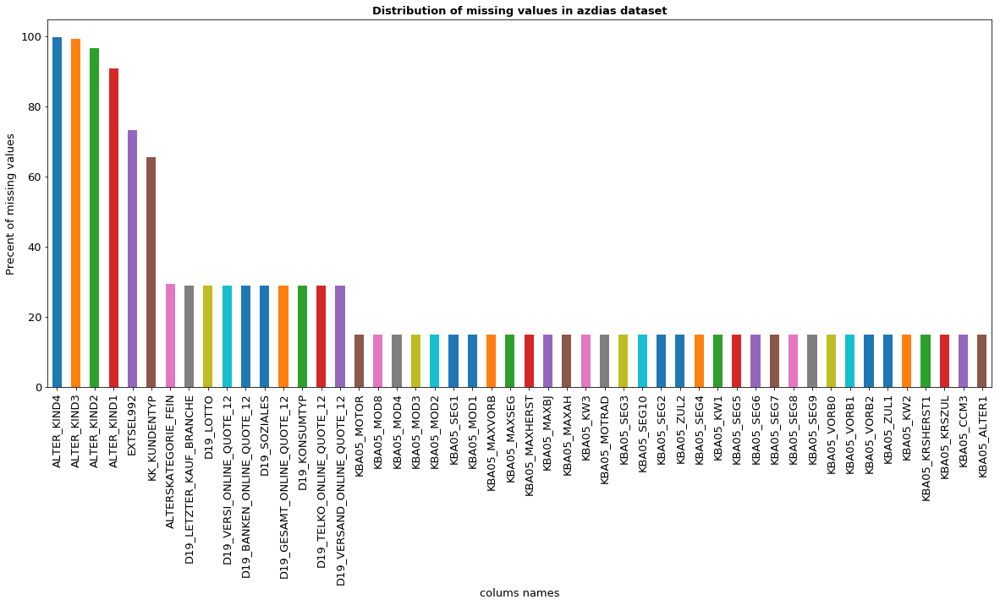

In [27]:
plt.title("Distribution of missing values in azdias dataset",fontsize=13,fontweight="bold")
plt.xlabel("colums names",fontsize=13)
plt.ylabel("Precent of missing values",fontsize=13)
(col_nul_percent_azdias.sort_values(ascending=False)[:50].plot(kind='bar', figsize=(20,8), fontsize=13));

In [28]:
# How look the missing values proportion by column at customers dataset?

# number of missing values by each column in costumers dataset
col_nul_percent_customers=(customers2.isnull().sum()/customers2.shape[0])*100

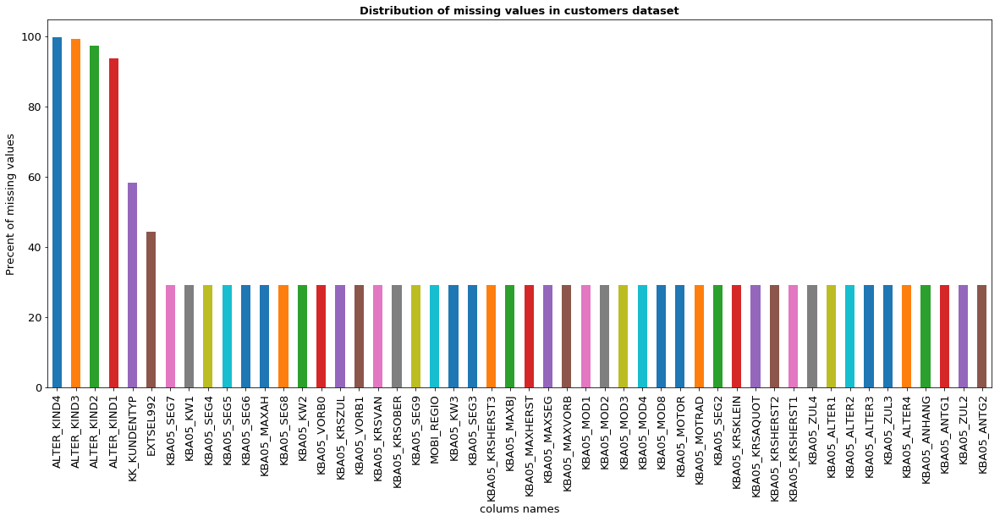

In [29]:
plt.title("Distribution of missing values in customers dataset",fontsize=13,fontweight="bold")
plt.xlabel("colums names",fontsize=13)
plt.ylabel("Precent of missing values",fontsize=13)
(col_nul_percent_customers.sort_values(ascending=False)[:50].plot(kind='bar', figsize=(20,8), fontsize=13));

### Missing values reduction
The cleaning process includes missing and unknow values treatment, we have several columns with missings and unknown data. 
We need to clean and eliminate variables with a "reasonable" number of missings and unknown values. But... <b>What is reasonable?</b> 
Based in the principled missing data methods for researchers, available at: https://www.ncbi.nlm.nih.gov/pmc/articles/PMC3701793/. 
I decided to use 20% as a limit, having in mind that the the proportion of missing data is directly related to the quality of statistical inferences. 

For azdias dataset we'd eliminate 16 columns and for customers dataset we're talking about 6 features.

In [30]:
#droping columns that have more than 20% of missing values
column_nans = (azdias2.isnull().sum()/azdias2.shape[0])*100
drop_cols = azdias2.columns[column_nans > 20]
print('columns to drop: ', drop_cols)


columns to drop:  Index(['ALTER_KIND1', 'ALTER_KIND2', 'ALTER_KIND3', 'ALTER_KIND4',
       'ALTERSKATEGORIE_FEIN', 'D19_BANKEN_ONLINE_QUOTE_12',
       'D19_GESAMT_ONLINE_QUOTE_12', 'D19_KONSUMTYP',
       'D19_LETZTER_KAUF_BRANCHE', 'D19_LOTTO', 'D19_SOZIALES',
       'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSAND_ONLINE_QUOTE_12',
       'D19_VERSI_ONLINE_QUOTE_12', 'EXTSEL992', 'KK_KUNDENTYP'],
      dtype='object')


In [31]:
#droping columns that have more than 20% of missing values
column_nans = (customers2.isnull().sum()/customers2.shape[0])*100
drop_cols = customers2.columns[column_nans >= 20]
print('columns to drop: ', drop_cols)

columns to drop:  Index(['AKT_DAT_KL', 'ALTER_HH', 'ALTER_KIND1', 'ALTER_KIND2', 'ALTER_KIND3',
       'ALTER_KIND4', 'ALTERSKATEGORIE_FEIN', 'ANZ_HAUSHALTE_AKTIV',
       'ANZ_HH_TITEL', 'ANZ_KINDER',
       ...
       'UNGLEICHENN_FLAG', 'VERDICHTUNGSRAUM', 'VHA', 'VHN', 'VK_DHT4A',
       'VK_DISTANZ', 'VK_ZG11', 'W_KEIT_KIND_HH', 'WOHNDAUER_2008',
       'WOHNLAGE'],
      dtype='object', length=253)


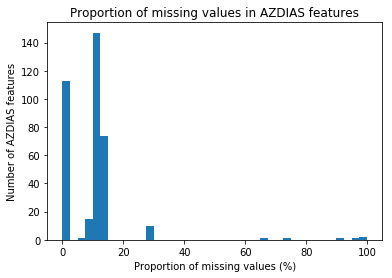

In [32]:
# let's see the distribution of missing values by column in azdias dataset
plt.hist(col_nul_percent_azdias, bins=40);

plt.xlabel('Proportion of missing values (%)')
plt.ylabel('Number of AZDIAS features')
plt.title('Proportion of missing values in AZDIAS features')
plt.show()

As we can see in the histogram and having, must of the feateres has less of 20% of missing values.
This histogram told us that a 20% is a reasonable limit for missing values.


In [33]:
# Inter quantile range
quartiles = col_nul_percent_azdias.quantile([.20,.40,.60, .80])

lowerq = quartiles[.20]
upperq = quartiles[.80]

IQR = upperq- lowerq

upperbound = lowerq-(IQR*1.4)
lowerbound = upperq+(IQR*1.4)

In [34]:
# Potential outliers
outliers = col_nul_percent_azdias>lowerbound

In [35]:
first_quartile = col_nul_percent_azdias.quantile(0.99)
first_quartile


79.52645864493807

In [36]:
# Defining the features to drop
features_to_drop = col_nul_percent_azdias[col_nul_percent_azdias > 20].index
features_to_drop

Index(['ALTER_KIND1', 'ALTER_KIND2', 'ALTER_KIND3', 'ALTER_KIND4',
       'ALTERSKATEGORIE_FEIN', 'D19_BANKEN_ONLINE_QUOTE_12',
       'D19_GESAMT_ONLINE_QUOTE_12', 'D19_KONSUMTYP',
       'D19_LETZTER_KAUF_BRANCHE', 'D19_LOTTO', 'D19_SOZIALES',
       'D19_TELKO_ONLINE_QUOTE_12', 'D19_VERSAND_ONLINE_QUOTE_12',
       'D19_VERSI_ONLINE_QUOTE_12', 'EXTSEL992', 'KK_KUNDENTYP'],
      dtype='object')

In [39]:
azdias2.drop(labels=features_to_drop, axis=1, inplace=True)

KeyError: "['ALTER_KIND1' 'ALTER_KIND2' 'ALTER_KIND3' 'ALTER_KIND4'\n 'ALTERSKATEGORIE_FEIN' 'D19_BANKEN_ONLINE_QUOTE_12'\n 'D19_GESAMT_ONLINE_QUOTE_12' 'D19_KONSUMTYP' 'D19_LETZTER_KAUF_BRANCHE'\n 'D19_LOTTO' 'D19_SOZIALES' 'D19_TELKO_ONLINE_QUOTE_12'\n 'D19_VERSAND_ONLINE_QUOTE_12' 'D19_VERSI_ONLINE_QUOTE_12' 'EXTSEL992'\n 'KK_KUNDENTYP'] not found in axis"

In [40]:
azdias2.shape

(891221, 350)

# Missing values per row

In [41]:
percent_missing_row = azdias2.isnull().mean(axis=1) * 100
percent_missing_row

0         67.428571
1          0.000000
2          0.000000
3          0.571429
4          0.000000
5          0.000000
6          0.000000
7          0.000000
8          0.000000
9          0.000000
10         0.000000
11        67.714286
12        18.285714
13        19.142857
14        67.714286
15        35.142857
16         0.571429
17        67.714286
18         0.000000
19         0.000000
20        36.000000
21         0.000000
22         0.000000
23        35.142857
24        67.714286
25         0.571429
26        55.142857
27         0.000000
28         0.000000
29         0.000000
30        62.857143
31         0.000000
32         0.000000
33         0.000000
34         0.000000
35        67.428571
36         0.000000
37         0.000000
38         0.000000
39         1.714286
40         0.857143
41         0.000000
42         0.000000
43         0.000000
44         0.000000
45         0.000000
46        62.857143
47         0.000000
48        67.714286
49         0.000000


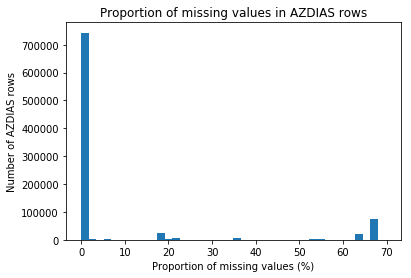

In [43]:
plt.hist(percent_missing_row, bins=40);

plt.xlabel('Proportion of missing values (%)')
plt.ylabel('Number of AZDIAS rows')
plt.title('Proportion of missing values in AZDIAS rows')
plt.show()

- The largest number of rows have few missing values, even zero, however there are some that have up to 60 missing values
- It is reasonable to eliminate the rows with more than 10% missing values. 

In [44]:
azdias3 = azdias2[percent_missing_row <= 10]

In [45]:
print('AZDIAS|Data shape (rows, cols): ', azdias3.shape)

AZDIAS|Data shape (rows, cols):  (751331, 350)


* LP_LEBENSPHASE_FEIN and LP_LEBENSPHASE_GROB are another two mixed features. Among the six columns that start with LP, there are duplicated information and we might need to do some additional data cleaning.

In [46]:
print('LP_LEBENSPHASE_FEIN: ', len(azdias["LP_LEBENSPHASE_FEIN"].unique()), \
      'values, ', azdias["LP_LEBENSPHASE_FEIN"].unique())

print('LP_LEBENSPHASE_GROB: ', len(azdias["LP_LEBENSPHASE_GROB"].unique()), \
      'values, ', azdias["LP_LEBENSPHASE_GROB"].unique())

print('LP_STATUS_FEIN: ', len(azdias["LP_STATUS_FEIN"].unique()), \
      'values, ', azdias["LP_STATUS_FEIN"].unique())

print('LP_STATUS_GROB: ', len(azdias["LP_STATUS_GROB"].unique()), \
      'values, ', azdias["LP_STATUS_GROB"].unique())

print('LP_FAMILIE_FEIN: ', len(azdias["LP_FAMILIE_FEIN"].unique()), \
      'values, ', azdias["LP_FAMILIE_FEIN"].unique())

print('LP_FAMILIE_GROB: ', len(azdias["LP_FAMILIE_GROB"].unique()), \
      'values, ', azdias["LP_FAMILIE_GROB"].unique())

LP_LEBENSPHASE_FEIN:  42 values,  [ 15.  21.   3.   0.  32.   8.   2.   5.  10.   4.   6.  23.  12.  20.   1.
  11.  25.  13.   7.  18.  31.  19.  38.  35.  30.  22.  14.  33.  29.  24.
  28.  37.  26.  39.  27.  36.   9.  34.  nan  40.  16.  17.]
LP_LEBENSPHASE_GROB:  14 values,  [  4.   6.   1.   0.  10.   2.   3.   5.   7.  12.  11.   9.   8.  nan]
LP_STATUS_FEIN:  11 values,  [  1.   2.   3.   9.   4.  10.   5.   8.   6.   7.  nan]
LP_STATUS_GROB:  6 values,  [  1.   2.   4.   5.   3.  nan]
LP_FAMILIE_FEIN:  13 values,  [  2.   5.   1.   0.  10.   7.  11.   3.   8.   4.   6.  nan   9.]
LP_FAMILIE_GROB:  7 values,  [  2.   3.   1.   0.   5.   4.  nan]


Columns LP_LEBENSPHASE_FEIN, LP_LEBENSPHASE_GROB, LP_FAMILIE_FEIN and LP_FAMILIE_GROB have 0 as one category. However, 0 should not be included according to DIAS Attributes - Values 2017.xlsx. Therefore, any 0s in the four columns will be converted into nan.

If we further look into DIAS Attributes - Values 2017.xlsx, we will find that LP_FAMILIE_GROB and LP_STATUS_GROB are broderer categorization of LP_FAMILIE_FEIN and LP_STATUS_FEIN, respectively. Since each pair contains the same information and the two fine categorizations have over 10 values, LP_FAMILIE_FEIN and LP_STATUS_FEIN will be dropped. Similarly, both LP_LEBENSPHASE_GROB and LP_LEBENSPHASE_FEIN will be dropped since they are complex mixed-features.

LP_STATUS_GROB and LP_FAMILIE_GROB can be re-encoded as the following.

LP_STATUS_GROB:

Social status

1: low-income earners

2: average earners

3: independants

4: houseowners

5: top earners

LP_FAMILIE_GROB:

Family type

1: single

2: couple

3: single parent

4: family

5: multiperson household

# Creating a function to LP_ functions
- replace 0 with nan values
- drop complex and/or duplicate columns
- split columns with mixed features.

In [47]:
# lp is short for LP_*
def encode_lp_files(df):
    """
    Re-encode LP_* columns:
    - replace 0s with nan values
    - drop complex and/or duplicate columns
    - split columns with mixed features.
    """
    # replace 0s with nan values
    cols = ["LP_LEBENSPHASE_FEIN","LP_LEBENSPHASE_GROB", "LP_FAMILIE_FEIN", "LP_FAMILIE_GROB"]
    df[cols] = df[cols].replace({0: np.nan})
    
    # drop complex and/or duplicate columns
    df.drop(['LP_FAMILIE_FEIN','LP_STATUS_FEIN','LP_LEBENSPHASE_FEIN','LP_LEBENSPHASE_GROB'], axis=1, inplace=True)
    
    # re-encode LP_STATUS_GROB and LP_FAMILIE_GROB
    status = {1: 1, 2: 1, 3: 2, 
              4: 2, 5: 2, 6: 3, 
              7: 3, 8: 4, 9: 4, 
              10: 5}
    familie = {1: 1, 2: 2, 3: 3, 
               4: 3, 5: 3, 6: 4, 
               7: 4, 8: 4, 9: 5, 
               10: 5, 11: 5}
    df["LP_STATUS_GROB"] = df["LP_STATUS_GROB"].map(status)                                              
    df["LP_FAMILIE_GROB"] = df["LP_FAMILIE_GROB"].map(familie)    
    
    return df

In [48]:
azdias = encode_lp_files(azdias3)

/opt/conda/lib/python3.6/site-packages/pandas/core/frame.py:3140: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[k1] = value[k2]
/opt/conda/lib/python3.6/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)
/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/opt/co

In [49]:
azdias.shape

(751331, 346)

- The 4th mixed-feature column is PRAEGENDE_JUGENDJAHRE. This feature takes unknown values being -1 and 0 and known values ranging from 1 to 15 and. It represents two types of donimating movements in the person's youth.

In [50]:
# How this looks like?

print('PRAEGENDE_JUGENDJAHRE: ', len(azdias["PRAEGENDE_JUGENDJAHRE"].unique()), \
      'values, ', azdias["PRAEGENDE_JUGENDJAHRE"].unique())

PRAEGENDE_JUGENDJAHRE:  16 values,  [14 15  8  3 10 11  9  6  4  0  5  2  1 12 13  7]


# Function to re-encode this feature to contain two values being Mainstream and Avantgarde, respectively.

* Mainstream: 0 -> [1, 3, 5, 8, 10, 12, 14]
* Avantgarde: 1 -> [2, 4, 6, 7, 9, 11, 13, 15]

In [51]:
# encode PRAEGENDE
def encode_PRAEGENDE(x):
    """
    Re-encode PRAEGENDE_JUGENDJAHRE:
    0: Mainstream
    1: Avantgarde
    """
    mainstream = [1, 3, 5, 8, 10, 12, 14]
    avantgarde = [2, 4, 6, 7, 9, 11, 13, 15]
    if x in mainstream: 
        return 0
    elif x in avantgarde: 
        return 1
    else:
        return x

In [52]:
azdias['PRAEGENDE_JUGENDJAHRE'] = azdias['PRAEGENDE_JUGENDJAHRE'].apply(lambda x: encode_PRAEGENDE(x))

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [53]:
# See the unique values in column PRAEGENDE_JUGENDJAHRE
print('PRAEGENDE_JUGENDJAHRE: ', len(azdias["PRAEGENDE_JUGENDJAHRE"].unique()), \
      'values, ', azdias["PRAEGENDE_JUGENDJAHRE"].unique())

PRAEGENDE_JUGENDJAHRE:  2 values,  [0 1]


In [54]:
azdias.shape

(751331, 346)

# High correlated features treatment (avoiding the impact of "Multicollinearity" in the performance of the model)

We will be implementing feature correlation to determine too high-correlated features since they many over-inflate the importance of a single feature. Too highly-correlated features are defined as having correlations with a column over 0.9.

Correlated features means that they bring the same information.

Data and feature correlation is considered one important step in the feature selection phase of the data pre-processing especially if the data type for the features is continuous.




In [55]:
correlation_matrix = azdias.corr().abs().round(2)

In [61]:
columns_total = list(azdias.columns.values)

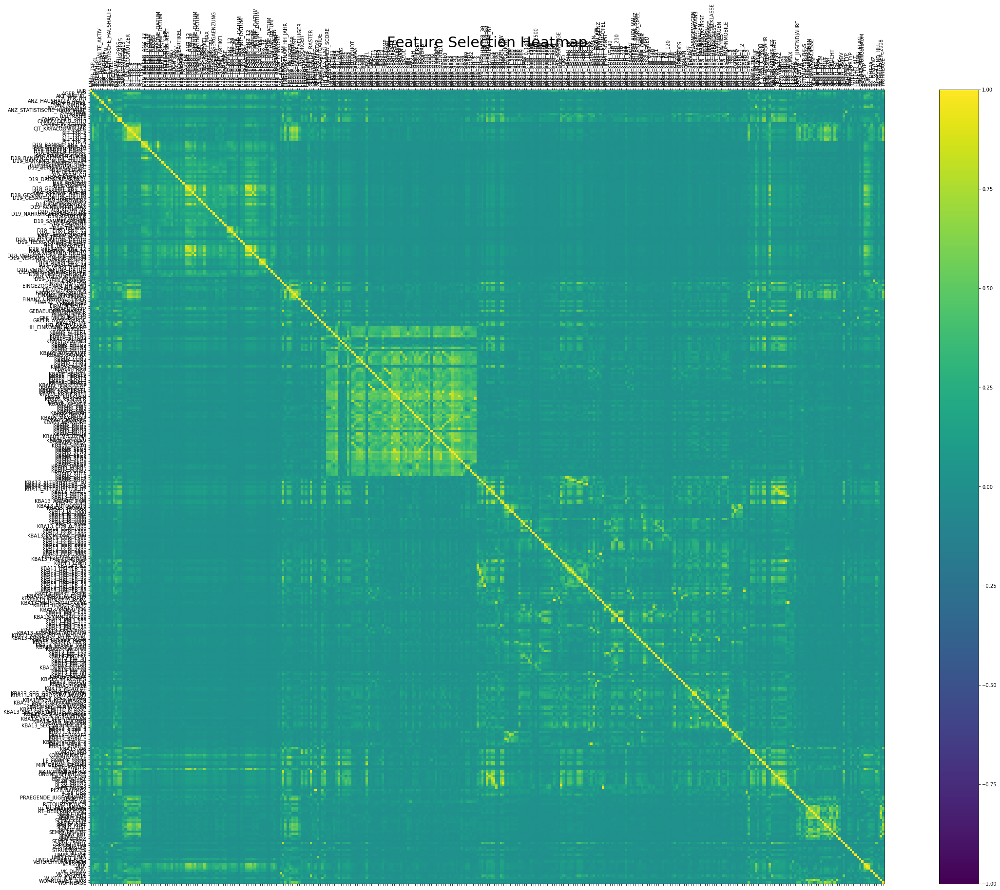

In [70]:
# plot correlation matrix
fig = plt.figure(figsize=(40, 30))
ax = fig.add_subplot(111)

names = columns_total

cax = ax.matshow(correlation_matrix, vmin=-1, vmax=1)
ticks = np.arange(0,343,1)
ax.set_xticks(ticks)
ax.set_yticks(ticks)
ax.set_xticklabels(names, rotation="vertical")
ax.set_yticklabels(names)
fig.colorbar(cax)
ax.set_title("Feature Selection Heatmap", size=30)
plt.savefig('heatmap.png')
plt.show()

* There are high crrelated features, as we can see in the heatmap.
* Lets drop those high correlated features in the following limits:
- correlation > +0.99
- correlation < -0.99

In [72]:
corr_features = set()
for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.9:
            col = correlation_matrix.columns[i]
            corr_features.add(col)

In [74]:
# There are 16 features highly correlated
len(corr_features)

16

In [75]:
azdias.drop(labels=corr_features, axis=1, inplace=True)

/opt/conda/lib/python3.6/site-packages/pandas/core/frame.py:3697: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  errors=errors)


In [76]:
azdias.shape

(751331, 330)

# Imputing missing values

We are going to use a simple imputer (univariate imputation by mean).


In [77]:
imputer = SimpleImputer(missing_values=np.nan, strategy='median')
azdias_imputed = pd.DataFrame(imputer.fit_transform(azdias))

NameError: name 'SimpleImputer' is not defined

## Part 1: Customer Segmentation Report

The main bulk of your analysis will come in this part of the project. Here, you should use unsupervised learning techniques to describe the relationship between the demographics of the company's existing customers and the general population of Germany. By the end of this part, you should be able to describe parts of the general population that are more likely to be part of the mail-order company's main customer base, and which parts of the general population are less so.

## Part 2: Supervised Learning Model

Now that you've found which parts of the population are more likely to be customers of the mail-order company, it's time to build a prediction model. Each of the rows in the "MAILOUT" data files represents an individual that was targeted for a mailout campaign. Ideally, we should be able to use the demographic information from each individual to decide whether or not it will be worth it to include that person in the campaign.

The "MAILOUT" data has been split into two approximately equal parts, each with almost 43 000 data rows. In this part, you can verify your model with the "TRAIN" partition, which includes a column, "RESPONSE", that states whether or not a person became a customer of the company following the campaign. In the next part, you'll need to create predictions on the "TEST" partition, where the "RESPONSE" column has been withheld.

In [ ]:
mailout_train = pd.read_csv('../../data/Term2/capstone/arvato_data/Udacity_MAILOUT_052018_TRAIN.csv', sep=';')